In [15]:
import os
import numpy as np
np.random.seed(123) 
import pandas as pd

from glob import glob
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
# sns.set()
# sns.set_style("whitegrid", {'axes.grid' : False})
%matplotlib inline

from skimage.io import imread
from skimage.transform import resize
from skimage import exposure
from skimage.color import rgb2grey
from skimage.morphology import disk
from skimage.filters import rank



/usr/local/lib/python3.6/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


InternalError: Failed to create session.

In [2]:
# reading pathes 
names_raw = glob('data/Raws/*/*.png')
names_labels = glob('data/Labels/*/*.png')

names_raw.sort()
names_labels.sort()
print("Count raw files: ", len(names_raw))
print("Count labels files: ",len(names_labels))

Count raw files:  119
Count labels files:  119


In [3]:
# variable for resizing
sizes = 512

# Function for preparing raw png files
def preparation_raw(x):
    img = imread(x)[:,150:1058,:] # Read and crop image
    img = rgb2grey(img) # to grey image with 1 channel 
    img = resize(img, (sizes,sizes), mode="symmetric") # resizing
    img = np.reshape(img,[sizes,sizes,1]) # reshaping from [h,w] to [h,w,channel] here we have one
    return img
    
    # Uncomment to work with 3 channels pngs
#     img = imread(x)[:,150:1058,:] # Read and crop image
#     img = resize(img, (sizes,sizes), mode="symmetric") # resizing
#     return img

# function for preparing labels files
def preparation_labels(x):
    img = imread(x)[:,150:1058,:] # Read and crop image
    img = rgb2grey(img) # to grey image with 1 channel. Need to make mask
    img = resize(img, (sizes,sizes), mode="symmetric") # resizing
    img[img>0] = 1 # binarization to 0 and 1 view
    img = np.expand_dims(img, axis=2)
    return img

raws = np.stack([preparation_raw(i) for i in names_raw], 0)
labels = np.stack([preparation_labels(i) for i in names_labels], 0)


# Overfit part
# take only two images and teach NN with it
# raws = np.stack([preparation_raw(i) for i in names_raw[15:19]], 0)
# labels = np.stack([preparation_labels(i) for i in names_labels[15:19]], 0)

print(raws.shape)
print(labels.shape)


/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


(119, 512, 512, 1)
(119, 512, 512, 1)


/usr/local/lib/python3.6/dist-packages/skimage/util/dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint16
  .format(dtypeobj_in, dtypeobj_out))
/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


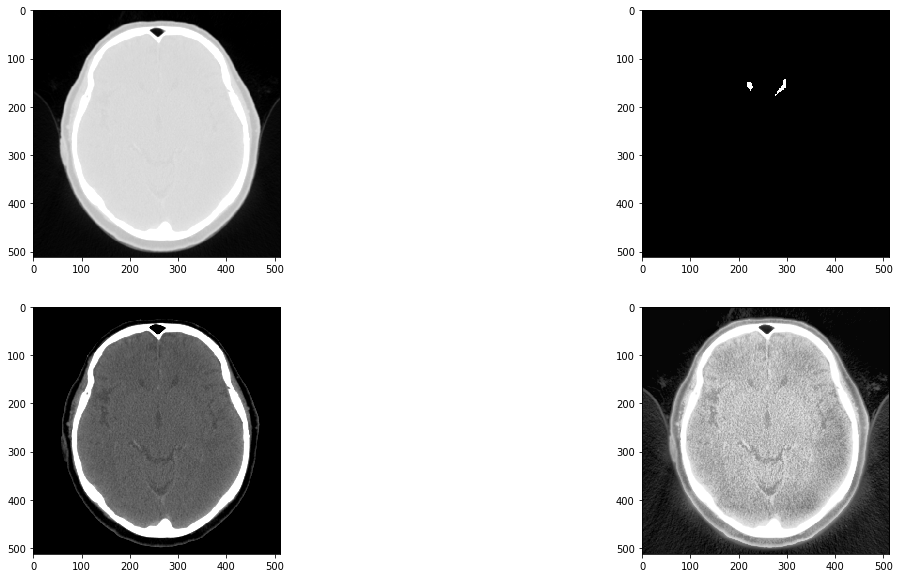

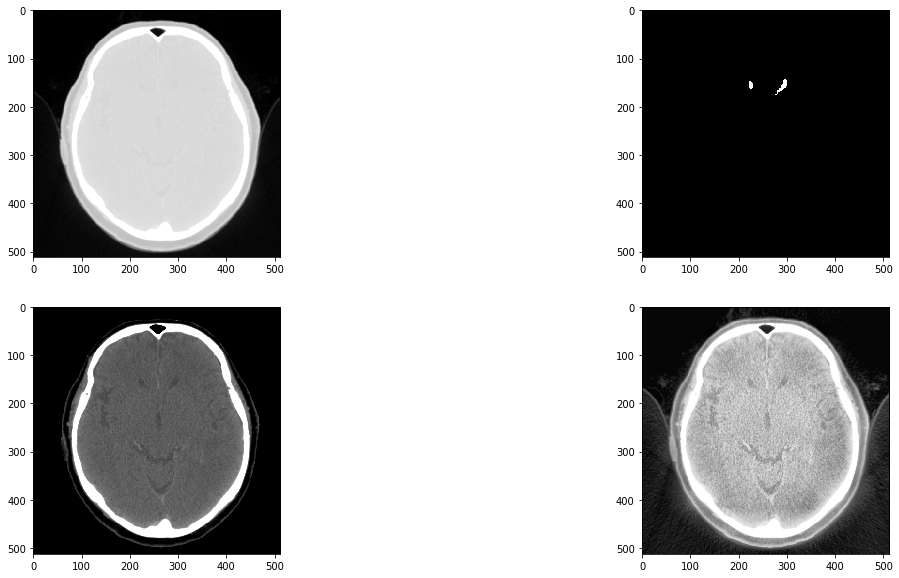

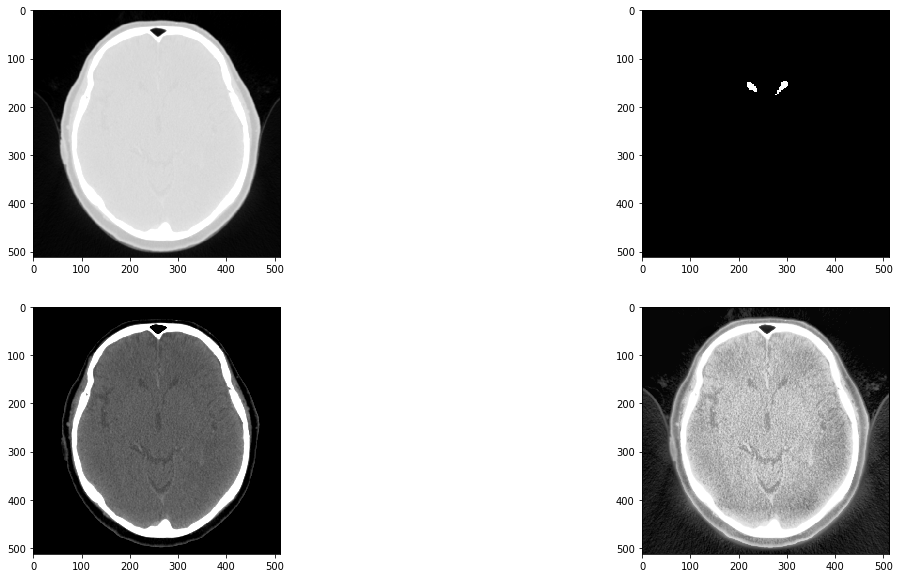

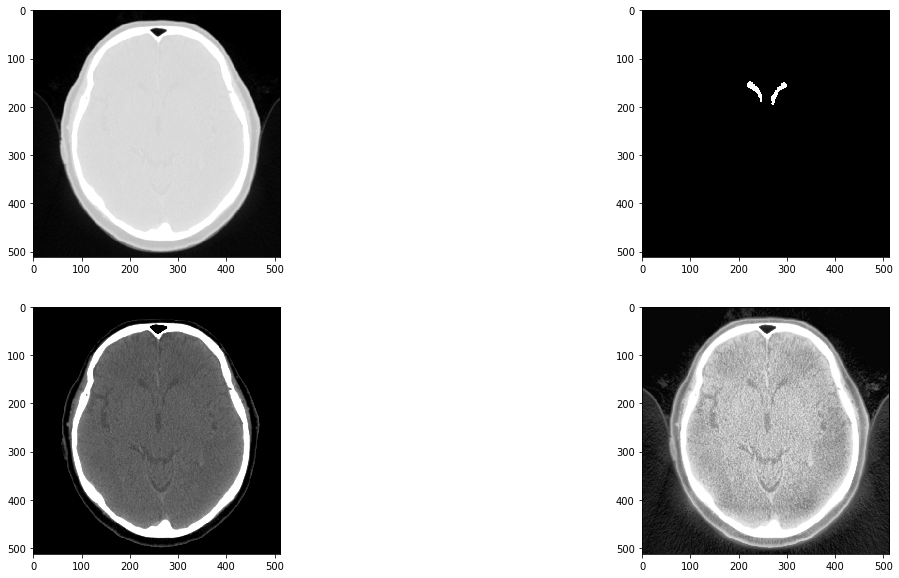

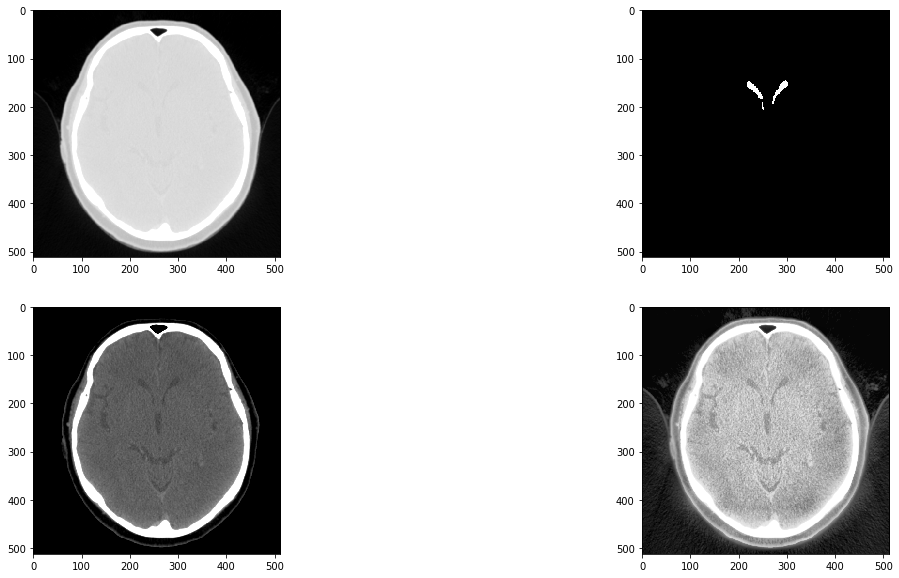

...

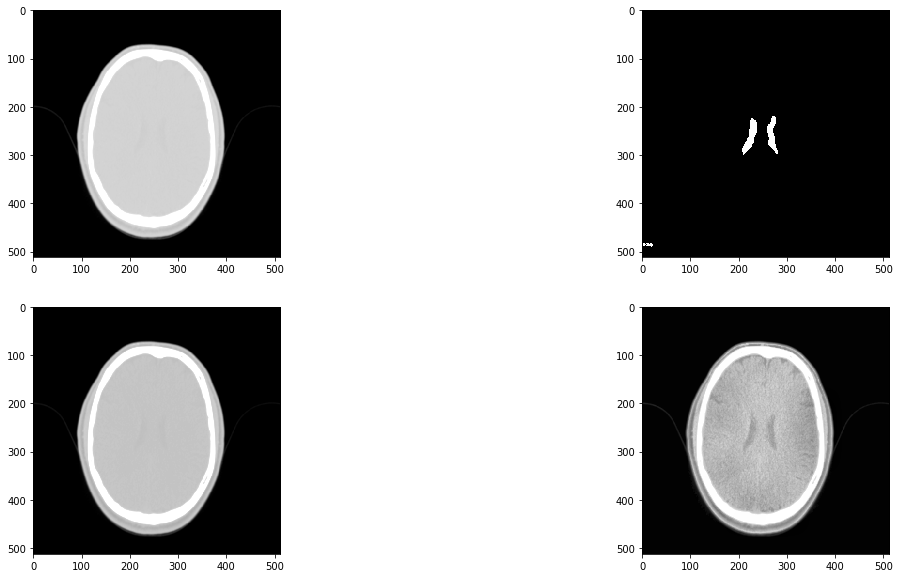

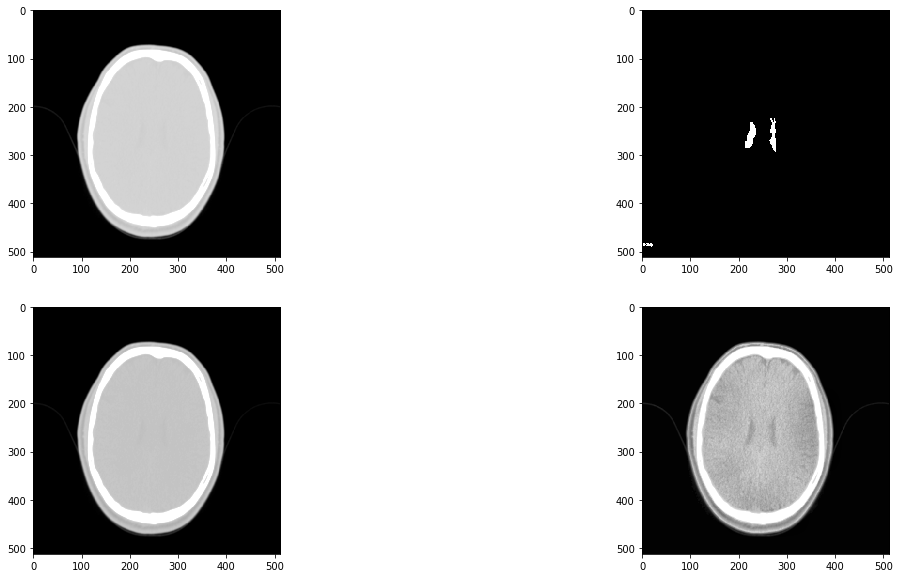

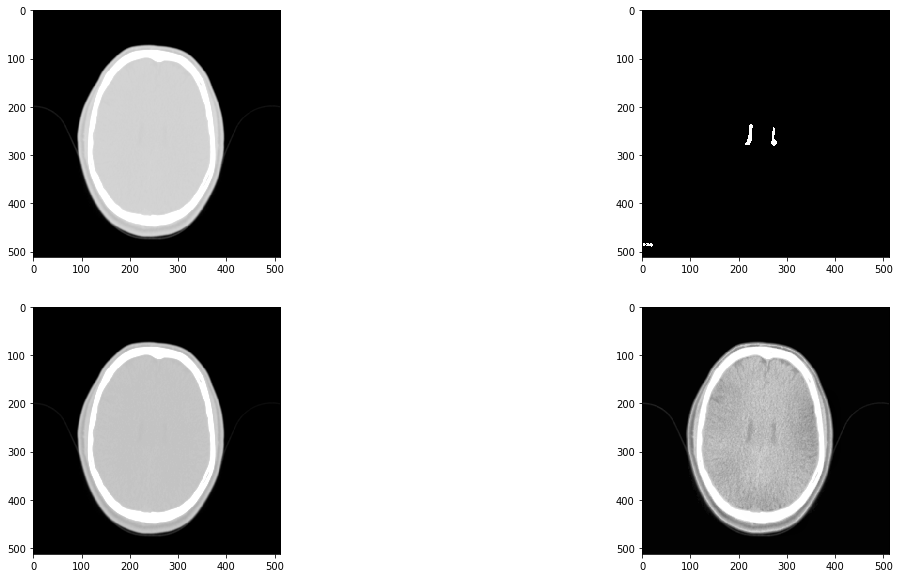

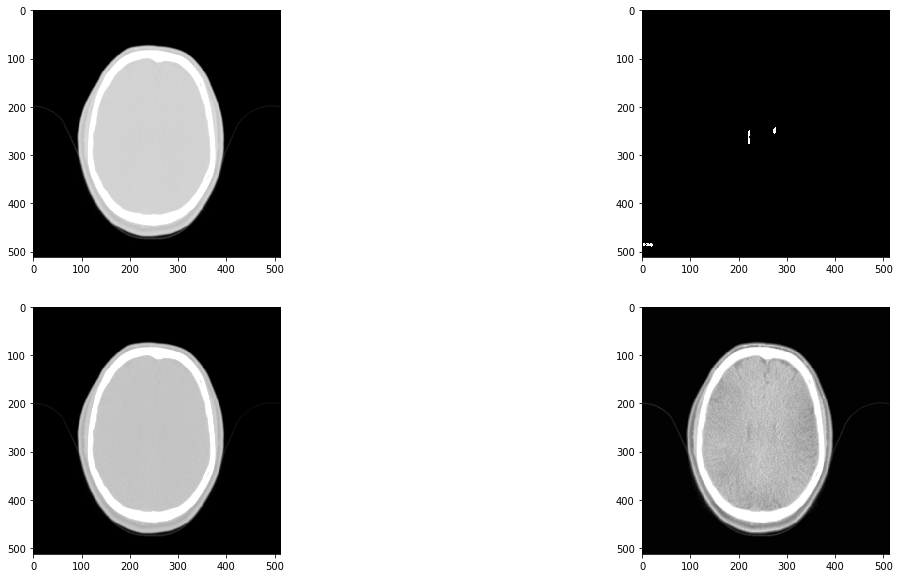

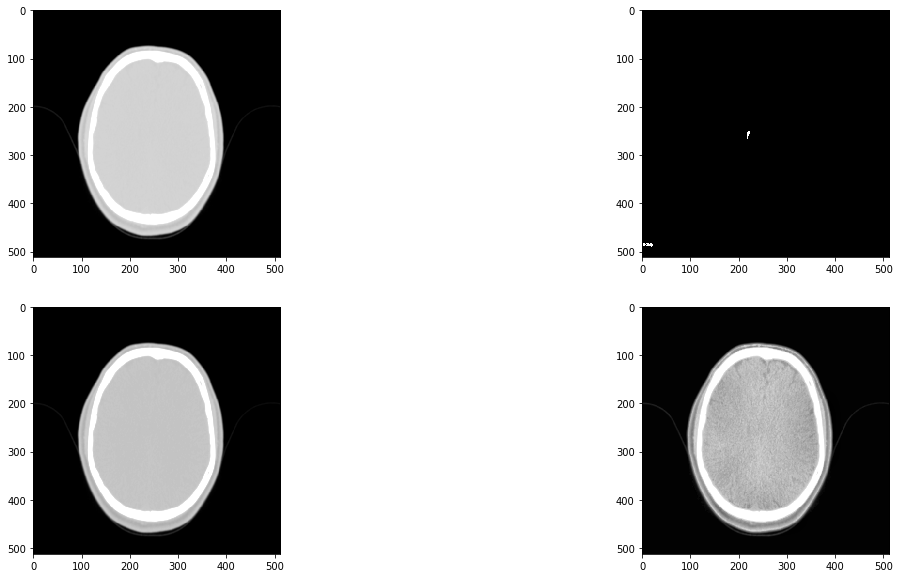

In [13]:

for x in range(len(raws-80)):
    raw = raws[x]
    label = labels[x]

    raw = np.reshape(raw, (512,512))
    label = np.reshape(label, (512,512))
    
    p2, p98 = np.percentile(raw, (45, 98))
    raw_rescale = exposure.rescale_intensity(raw, in_range=(p2, p98))

    img_adapteq = exposure.equalize_adapthist(raw, clip_limit=0.03)
    
    # Gamma
    gamma_corrected = exposure.adjust_gamma(raw, 2)
    # Logarithmic
    logarithmic_corrected = exposure.adjust_log(raw, 1)
    
    
    fig, axarr = plt.subplots(2,2, figsize=(20, 10))

    axarr[0,0].imshow(logarithmic_corrected, cmap=plt.cm.gray)
    axarr[0,1].imshow(label, cmap=plt.cm.gray)
    axarr[1,0].imshow(raw_rescale, cmap=plt.cm.gray)
    axarr[1,1].imshow(img_adapteq, cmap=plt.cm.gray)
    


In [ ]:
for x in range(len(raws-80)):
    raw = raws[x]
    label = labels[x]

    raw = np.reshape(raw, (512,512))
    label = np.reshape(label, (512,512))
    
    p2, p98 = np.percentile(raw, (60, 98))
    raw_rescale = exposure.rescale_intensity(raw, in_range=(p2, p98))

#     img_adapteq = exposure.equalize_adapthist(raw, clip_limit=0.03)
    
#     # Gamma
#     gamma_corrected = exposure.adjust_gamma(raw, 2)
    
    
    
    fig, axarr = plt.subplots(2,2, figsize=(20, 10))

    axarr[0,0].imshow(raw, cmap=plt.cm.gray)
    axarr[0,1].imshow(label, cmap=plt.cm.gray)
    axarr[1,0].imshow(raw_rescale, cmap=plt.cm.gray)
    axarr[1,1].imshow(img_adapteq, cmap=plt.cm.gray)